<div style="text-align: center; line-height: 0; padding-top: 9px;">
  <img src="https://drive.google.com/uc?export=view&id=1LqkEgbpZj8A99Y9T59eBp9fEIZbpg6P2" alt="Snowflake Snowpark Classroom" style="width: 800px">
</div>

# Classroom 1.3 - Input/Output Operations Using Snowflake Snowpark

In this notebook, you will learn how to input or output operations using Snowflake Snowpark API for Python

## Learning Objectives

By the end of this classroom, you should be able to:
- Access and load data using Snowpark DataFrameReader
- Writing the data from dataframe to output Destination
- Exploring File Operations

In [ ]:
# Let's get started with Snowpark
from assets.config import connection_builder
session = connection_builder()

## Section 1 - Access and load data in various supported formats using Snowpark DataFrameReader Class

The DataFrameReader provides methods to load data in various supported formats from a Snowflake stage to a DataFrame. The paths provided to the DataFrameReader must refer to Snowflake stages.

To use the DataFrameReader:
- Access an instance of a DataFrameReader by using the Session.read property
- Specify any format-specific options and copy options by calling the option() or options() method
- Specify the schema of the data that you plan to load and pass it to the schema() method if the file format is CSV. Other file formats such as JSON, XML, Parquet, ORC, and AVRO don’t accept a schema.
- Specify the format of the data by calling the method named after the format (e.g. csv(), json(), etc.). These methods return a DataFrame that is configured to load data in the specified format.
- Call a DataFrame method that performs an action (e.g. DataFrame.collect()) to load the data from the file.

In [6]:
from snowflake.snowpark.functions import col
from snowflake.snowpark.types import IntegerType, StringType, StructField, StructType

session.sql('CREATE OR REPLACE TEMPORARY STAGE FILE_REPOS').collect()
session.file.put('assets/resources/csv_dataset.csv','@file_repos',auto_compress=False)
session.file.put('assets/resources/json_dataset.json','@file_repos',auto_compress=True)
session.file.put('assets/resources/avro_dataset.avro','@file_repos',auto_compress=True)
session.file.put('assets/resources/xml_dataset.xml','@file_repos',auto_compress=True)
session.file.put('assets/resources/xml_dataset.xml','@file_repos',auto_compress=True)
session.file.put('assets/resources/orc_dataset.orc','@file_repos',auto_compress=True)

print('----------------- Files Uploaded On @FILE_REPOS Stage -----------------')
session.sql('list @file_repos').show()

print('----------------- Reading CSV data Using read.options().schema().csv() -----------------')
csv_schema = StructType([StructField('Email No.',StringType()), StructField('the',IntegerType()), StructField('to',IntegerType())])
session.read.options({'field_delimiter':',', 'skip_header':1,'pattern':'.*[.]csv'}).schema(csv_schema).csv('@file_repos/csv_dataset.csv').show()

print('----------------- Reading JSON data Using read.json() -----------------')
session.read.option("compression","gzip").json('@file_repos/json_dataset.json.gz').show()

print('----------------- Reading AVRO data Using read.avro() -----------------')
session.read.avro('@file_repos/avro_dataset.avro').show()

print('----------------- Reading XML data Using read.xml() -----------------')
session.read.xml('@file_repos/xml_dataset.xml').show()

print('----------------- Reading ORC data Using read.orc() -----------------')
session.read.orc('@file_repos/orc_dataset.orc').show()

print('----------------- Reading Table data Using read.table() -----------------')
session.read.table('SNOWFLAKE.ACCOUNT_USAGE.QUERY_HISTORY').show()

----------------- Files Uploaded On @FILE_REPOS Stage -----------------
---------------------------------------------------------------------------------------------------------------
|"name"                           |"size"   |"md5"                             |"last_modified"               |
---------------------------------------------------------------------------------------------------------------
|file_repos/avro_dataset.avro.gz  |5577232  |5256d1e8fc392e932fbcd165de86b50b  |Mon, 9 Oct 2023 11:08:11 GMT  |
|file_repos/csv_dataset.csv       |160      |edf65985e230afdec27dee9b97ceac78  |Mon, 9 Oct 2023 11:08:02 GMT  |
|file_repos/json_dataset.json.gz  |1104     |7eae20c241753aeda97a77a9c855be7f  |Mon, 9 Oct 2023 11:08:03 GMT  |
|file_repos/orc_dataset.orc       |41936    |ce17861678633aa0a073db5f8b7989ad  |Mon, 9 Oct 2023 11:08:14 GMT  |
|file_repos/xml_dataset.xml.gz    |1392     |364f0e3baa39c7b81b3e42fd13b9b8e7  |Mon, 9 Oct 2023 11:08:13 GMT  |
--------------------------------

## Section 2 - Writing Data From Dataframe to Output Destination using Snowflake DataFrameWriter Class

snowflake.snowpark.DataFrameWriter provides methods for writing data from a DataFrame to supported output destinations.

To use DataFrameWriter:
- Create an instance of a DataFrameWriter by accessing the DataFrame.write property.
- Specify the save mode by calling mode(), which returns the same DataFrameWriter that is configured to save data using the specified mode. The default mode is “errorifexists”
- Call save_as_table() or copy_into_location() to save the data to the specified destination

### **snowflake.snowpark.DataFrameWriter.copy_into_location**

Allows you to load the data from a dataframe to a stage.

Important Parameters

- location – The destination stage location.
- partition_by – Specifies an expression used to partition the unloaded table rows into separate files. It can be a Column, a column name, or a SQL expression.
- file_format_name – Specifies an existing named file format to use for unloading data from the table. The named file format determines the format type (CSV, JSON, PARQUET), as well as any other format options, for the data files.
- file_format_type – Specifies the type of files unloaded from the table. If a format type is specified, additional format-specific options can be specified in format_type_options.
- format_type_options – Depending on the file_format_type specified, you can include more format specific options. Use the options documented in the Format Type Options.
- header – Specifies whether to include the table column headings in the output files.
- copy_options – The kwargs that are used to specify the copy options. Use the options documented in the [Copy Options](https://docs.snowflake.com/en/sql-reference/sql/copy-into-location#copy-options-copyoptions).


### **snowflake.snowpark.DataFrameWriter.mode**

- **append**: Append data of this DataFrame to existing data.
- **overwrite**: Overwrite existing data.
- **errorifexists**: Throw an exception if data already exists.
- **ignore**: Ignore this operation if data already exists.

Default value is **errorifexists**.

### **snowflake.snowpark.DataFrameWriter.saveAsTable**

Allows you to store the data into a table from a dataframe.

Important Parameters

- **table_name** – A string or list of strings representing table name. If input is a string, it represents the table name; if input is of type iterable of strings, it represents the fully-qualified object identifier (database name, schema name, and table name).
- **mode** – One of the following values. When it’s None or not provided, the save mode set by mode() is used.
    - ”append”: Append data of this DataFrame to existing data.
    - ”overwrite”: Overwrite existing data.
    - ”errorifexists”: Throw an exception if data already exists.
    - ”ignore”: Ignore this operation if data already exists.
- **column_order** – When mode is “append”, data will be inserted into the target table by matching column sequence or column name. Default is “index”. When mode is not “append”, the column_order makes no difference.
    - ”index”: Data will be inserted into the target table by column sequence. “name”: Data will be inserted into the target table by matching column names. If the target table has more columns than the source DataFrame, use this one.
- **table_type** – The table type of table to be created. The supported values are: temp, temporary, and transient. An empty string means to create a permanent table. Learn more about table types here.
- **block** – A bool value indicating whether this function will wait until the result is available. When it is False, this function executes the underlying queries of the dataframe asynchronously and returns an AsyncJob.

In [7]:
qh_df = session.sql('SELECT query_id,warehouse_name,user_name,query_tag,query_text FROM SNOWFLAKE.ACCOUNT_USAGE.QUERY_HISTORY LIMIT 1000')

# LOADING DATA FROM A DATAFRAME TO SNOWFLAKE STAGE
qh_df.write.mode('append').copy_into_location(location='@file_repos/unload/',partition_by='user_name',file_format_type='parquet',header=True)
session.sql('list @file_repos/unload/').show()
session.read.parquet('@file_repos/unload/DIVYANSH/').count()

qh_df.write.save_as_table(table_name='query_history_report',mode='overwrite',table_type='temp')
session.table('query_history_report').show()    

---------------------------------------------------------------------------------------------------------------------------------
|"name"                                              |"size"  |"md5"                             |"last_modified"               |
---------------------------------------------------------------------------------------------------------------------------------
|file_repos/unload/DIVYANSH/data_01af88a2-3200-e...  |27424   |e50626dc41a08fb9dd9ab06c221250d0  |Mon, 9 Oct 2023 13:54:32 GMT  |
|file_repos/unload/WORKSHEETS_APP_USER/data_01af...  |4144    |fb76e41323f2cbe6228c6eee58b0c4da  |Mon, 9 Oct 2023 13:54:32 GMT  |
---------------------------------------------------------------------------------------------------------------------------------

--------------------------------------------------------------------------------------------------------------------------------------------
|"QUERY_ID"                            |"WAREHOUSE_NAME"  |"USER_NAME"  |"QUER

## Section 3 - Exploring File Operations using Snowflake Snowpark API

snowflake.snowpark.FileOperation provides methods for working on files in a stage. To access an object of this class, use [Session.file](https://docs.snowflake.com/ko/developer-guide/snowpark/reference/python/api/snowflake.snowpark.Session.file.html#snowflake.snowpark.Session.file)
Method | Description
| -- | --|
get | Downloads the specified files from a path in a stage to a local directory.
get_stream | Downloads the specified files from a path in a stage and expose it through a stream.
put | Uploads local files to the stage.
put_stream | Uploads local files to the stage via a file stream.

**_The put_stream uses the file/data already in memory using a BytesIO object and then writes the object to the internal stage. Where the PUT saves the physical file on the disk and then writes the file to the internal stage_**

### **snowflake.snowpark.PutResult**

Represents the results of uploading a local file to a stage location.


|Attributes | Description|
|--|--|
message | The detailed message of the upload status.
source | The source file path.
source_compression | The source file compression format.
source_size | The size in bytes of the source file.
status | Status indicating whether the file was uploaded to the stage.
target | The file path in the stage where the source file is uploaded.
target_compression | The target file compression format.
target_size | The size in bytes of the target file.

For Instance - [PutResult(source='avatar.png', target='avatar.png.gz', source_size=1308644, target_size=1300880, source_compression='NONE', target_compression='GZIP', status='UPLOADED', message='')]

### **snowflake.snowpark.GetResult**

Represents the results of downloading a file from a stage location to the local file system.

|Attributes | Description|
|--|--|
file | The downloaded file path.
message | The detailed message about the download status.
size | The size in bytes of the downloaded file.
status | Indicates whether the download is successful.

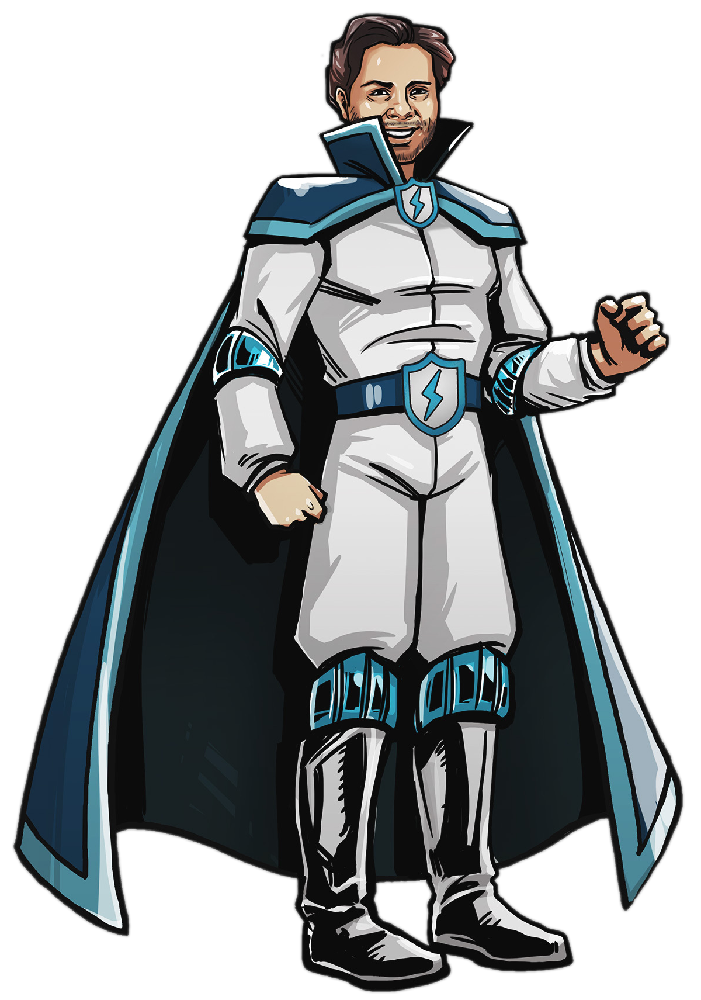

In [8]:
# do make sure to run pip install Pillow
from PIL import Image
session.sql('list @file_repos/').collect()

# Unloading the file to local system
session.file.get('@file_repos/json_dataset.json.gz','assets/resources/unloads/')

# Loading the file to snowflake Stage
session.file.put('assets/*.png','@file_repos/',)

# Get_Stream lets you download files from a specific location in a stage and stream their content.
# The decompress argument is a setting that determines whether or not the downloaded file will be automatically decompressed using gzip.
df_stream = session.file.get_stream('@file_repos/avatar.png.gz',decompress=True)
Image.open(df_stream)
#df_stream.close()

